# **YOLOv8**

In [ ]:
!nvidia-smi

Wed Apr 10 22:31:31 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0              43W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.4/750.4 kB 13.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/side-body-final'
!ls '/content/drive/My Drive/side-body-final/train'
!ls '/content/drive/My Drive/side-body-final/valid'

Mounted at /content/drive
data.yaml  pretrained-n.pt  scratch-n.pt  test	train  valid
images	labels	labels.cache
images	labels	labels.cache


In [ ]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8s.pt")
yaml_file = "/content/drive/My Drive/side-body-final/data.yaml"
results = model.train(data=yaml_file, epochs=100, imgsz=320)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

100%|██████████| 21.5M/21.5M [00:00<00:00, 359MB/s]


Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/My Drive/side-body-final/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, sh

100%|██████████| 755k/755k [00:00<00:00, 108MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 319MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/My Drive/side-body-final/train/labels.cache... 1914 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1914/1914 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.68G      1.529      1.431      1.409         55        320: 100%|██████████| 120/120 [02:14<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.45it/s]

                   all        146        423      0.771       0.71      0.764      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.75G      1.516      1.146      1.413         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.58it/s]

                   all        146        423      0.761       0.63      0.685      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.62G      1.528      1.165      1.418         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.85it/s]

                   all        146        423      0.746      0.618      0.672      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.64G      1.543      1.165       1.42         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.31it/s]

                   all        146        423      0.739      0.689      0.736      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.64G      1.493      1.135      1.418         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.63it/s]

                   all        146        423      0.754      0.738       0.79      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.64G      1.451      1.068      1.378         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.54it/s]

                   all        146        423      0.748      0.744      0.772      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.64G      1.444      1.057      1.377         54        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.67it/s]

                   all        146        423      0.853      0.749      0.825      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.64G       1.41      1.015      1.353         81        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.93it/s]

                   all        146        423      0.842      0.763      0.825      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.61G      1.395          1      1.339         82        320: 100%|██████████| 120/120 [00:10<00:00, 11.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.24it/s]

                   all        146        423      0.867      0.756      0.848      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.64G      1.381     0.9607      1.334         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.57it/s]

                   all        146        423      0.867      0.817      0.866      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100       1.6G      1.359     0.9168      1.317         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.81it/s]

                   all        146        423      0.853      0.782      0.854      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       1.6G      1.339     0.9266      1.308         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.70it/s]

                   all        146        423      0.847       0.78       0.84      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.59G      1.318     0.8986       1.29         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.17it/s]

                   all        146        423      0.837      0.794      0.855      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.59G      1.315     0.8906      1.301         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.78it/s]

                   all        146        423      0.883      0.781      0.843      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.61G        1.3      0.875      1.284         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]

                   all        146        423      0.891      0.812      0.869      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       1.6G      1.277     0.8591      1.269         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.05it/s]

                   all        146        423      0.864       0.81      0.865      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.49G       1.26     0.8444      1.263         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]

                   all        146        423      0.865       0.81      0.863      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.59G      1.256     0.8197      1.258         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.03it/s]

                   all        146        423      0.883      0.777      0.849      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       1.6G       1.22     0.7893      1.241         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.56it/s]


                   all        146        423      0.862      0.801      0.869      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       1.6G      1.204     0.7825      1.231         34        320: 100%|██████████| 120/120 [00:10<00:00, 11.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.46it/s]

                   all        146        423      0.855      0.813      0.876       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       1.6G        1.2     0.7721      1.228         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.36it/s]

                   all        146        423       0.89      0.804      0.886      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       1.6G      1.206     0.7726       1.23         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.51it/s]

                   all        146        423      0.912      0.785      0.876      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.61G      1.182     0.7534      1.217         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.21it/s]

                   all        146        423      0.872      0.791      0.861      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100       1.6G      1.173     0.7449      1.214         73        320: 100%|██████████| 120/120 [00:10<00:00, 11.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.05it/s]

                   all        146        423      0.893      0.827      0.892      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       1.6G      1.169     0.7358      1.208         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]

                   all        146        423      0.883        0.8       0.87      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       1.6G      1.157     0.7176      1.195         58        320: 100%|██████████| 120/120 [00:10<00:00, 11.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.71it/s]

                   all        146        423      0.924      0.792      0.891      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.61G      1.123     0.7168      1.187         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.76it/s]

                   all        146        423      0.873      0.832      0.897      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.61G      1.114     0.7094      1.187         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.63it/s]

                   all        146        423      0.884      0.818      0.882      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.61G      1.127     0.7049      1.189         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.24it/s]

                   all        146        423      0.876       0.81      0.876      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.61G      1.102     0.6903      1.176         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.40it/s]

                   all        146        423      0.883      0.804      0.884      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100       1.6G       1.11     0.6991      1.175         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.69it/s]

                   all        146        423       0.88      0.801      0.873      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       1.6G      1.087       0.68      1.169         68        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.03it/s]

                   all        146        423      0.894      0.816      0.876      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100       1.6G      1.099     0.6847      1.166         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.04it/s]

                   all        146        423       0.91      0.783      0.878      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       1.6G      1.076     0.6692      1.162         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.92it/s]

                   all        146        423      0.875      0.824      0.886      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       1.6G      1.067     0.6587      1.154         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.58it/s]

                   all        146        423      0.907      0.821      0.885      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.61G      1.066     0.6563      1.145         44        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.12it/s]

                   all        146        423      0.876      0.843      0.891      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100       1.6G      1.067     0.6417      1.145         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.28it/s]

                   all        146        423      0.883      0.822      0.889      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       1.6G      1.054     0.6486      1.146         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.41it/s]

                   all        146        423      0.889      0.825      0.886      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100       1.6G      1.032     0.6342      1.135         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.89it/s]

                   all        146        423      0.883      0.826      0.888       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       1.6G      1.038      0.636      1.141         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.75it/s]

                   all        146        423       0.91      0.771      0.875      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       1.6G      1.021     0.6272      1.132         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.68it/s]

                   all        146        423      0.907      0.775      0.874      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       1.6G      1.022     0.6221      1.119         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.96it/s]

                   all        146        423      0.862       0.83      0.875      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100       1.6G       1.01     0.6218      1.128         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.25it/s]

                   all        146        423      0.888       0.84      0.864      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       1.6G      1.004     0.6154       1.13         39        320: 100%|██████████| 120/120 [00:10<00:00, 11.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.15it/s]

                   all        146        423      0.914      0.779      0.875      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.61G      1.007     0.6127      1.123         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]

                   all        146        423      0.892      0.778      0.867      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       1.6G     0.9788     0.6009      1.116         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.44it/s]

                   all        146        423      0.917      0.807      0.878      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       1.6G     0.9825     0.5952      1.114         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.80it/s]

                   all        146        423      0.905      0.776      0.867      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.61G     0.9767     0.5817      1.105         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.67it/s]

                   all        146        423       0.89      0.814      0.878      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.61G     0.9576      0.578      1.098         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.33it/s]

                   all        146        423      0.914      0.798      0.881      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       1.6G      0.953     0.5743      1.102         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.44it/s]


                   all        146        423      0.903       0.81      0.871      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100       1.6G     0.9559     0.5695      1.096         30        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.39it/s]

                   all        146        423      0.907      0.812      0.884      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100       1.6G      0.949     0.5715      1.098         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.37it/s]

                   all        146        423      0.907      0.811      0.887      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100       1.6G     0.9407     0.5637      1.084         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]

                   all        146        423      0.899      0.796      0.862      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       1.6G     0.9282     0.5498      1.085         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.80it/s]

                   all        146        423      0.918      0.802      0.871      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100       1.6G     0.9261     0.5592      1.086         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.05it/s]

                   all        146        423      0.897      0.805      0.871      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100       1.6G     0.9148     0.5464       1.08         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.17it/s]

                   all        146        423      0.906      0.802      0.874      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100       1.6G       0.92     0.5521       1.08         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]

                   all        146        423      0.925       0.79      0.872      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       1.6G     0.9021     0.5373      1.071         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.79it/s]

                   all        146        423      0.927      0.785      0.887      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.61G     0.9052     0.5369      1.074         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.82it/s]

                   all        146        423      0.897      0.819      0.876      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       1.6G     0.8851     0.5311      1.063         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.07it/s]

                   all        146        423      0.875       0.84      0.886      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       1.6G     0.8954     0.5316      1.068         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.20it/s]


                   all        146        423      0.879      0.836       0.89      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       1.6G     0.8831     0.5204      1.058         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.75it/s]

                   all        146        423       0.89      0.812      0.876      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.61G     0.8643      0.512      1.053         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.67it/s]

                   all        146        423      0.931      0.779      0.879      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100       1.6G     0.8769     0.5195      1.055         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.59it/s]

                   all        146        423      0.909      0.815      0.881      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100       1.6G      0.861     0.5049      1.047         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.77it/s]

                   all        146        423      0.938      0.794      0.885       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.61G     0.8483     0.5079      1.045         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]


                   all        146        423      0.892       0.79      0.873      0.562

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.61G     0.8493     0.5038      1.044         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.69it/s]


                   all        146        423      0.861      0.828       0.87       0.57

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.61G     0.8316     0.4903      1.036         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.71it/s]

                   all        146        423      0.898      0.785      0.868      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100       1.6G     0.8325     0.4983      1.037         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.77it/s]

                   all        146        423      0.912      0.807      0.879      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       1.6G     0.8301     0.4845      1.039         36        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.63it/s]

                   all        146        423      0.893        0.8      0.868      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100       1.6G     0.8239     0.4938      1.033         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.23it/s]

                   all        146        423      0.897      0.803      0.868      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       1.6G     0.8278     0.4895      1.033         74        320: 100%|██████████| 120/120 [00:10<00:00, 11.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]

                   all        146        423      0.934       0.78       0.87      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100       1.6G     0.8133       0.48      1.027         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.19it/s]

                   all        146        423      0.942      0.795      0.879      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       1.6G     0.8093     0.4837      1.028         70        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.56it/s]

                   all        146        423      0.908       0.81      0.881      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       1.6G     0.8032     0.4738      1.027         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.63it/s]

                   all        146        423      0.924       0.78      0.868      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       1.6G     0.7947     0.4698      1.022         65        320: 100%|██████████| 120/120 [00:10<00:00, 11.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.65it/s]

                   all        146        423      0.872      0.816      0.874       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100       1.6G     0.7975     0.4772      1.023         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.38it/s]


                   all        146        423      0.901       0.81      0.872      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       1.6G     0.8072     0.4725      1.025         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.22it/s]

                   all        146        423      0.875      0.831      0.874      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       1.6G     0.7857     0.4607      1.016         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.80it/s]

                   all        146        423      0.899      0.811      0.874      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       1.6G     0.7737     0.4523      1.013         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.16it/s]

                   all        146        423       0.89      0.828      0.881      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.61G     0.7774     0.4601      1.016         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.37it/s]

                   all        146        423      0.902      0.817      0.871      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       1.6G     0.7724     0.4622      1.011         80        320: 100%|██████████| 120/120 [00:10<00:00, 11.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.96it/s]

                   all        146        423      0.908      0.797      0.863      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       1.6G     0.7692     0.4481      1.008         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.74it/s]

                   all        146        423      0.907      0.806      0.882      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       1.6G     0.7614     0.4507      1.005         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.40it/s]

                   all        146        423      0.924      0.808      0.881      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.61G     0.7652     0.4534      1.007         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.20it/s]

                   all        146        423      0.916      0.813      0.873      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       1.6G     0.7552     0.4421      1.004         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.71it/s]

                   all        146        423      0.918      0.793      0.872      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.61G     0.7486      0.438      1.004         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.41it/s]


                   all        146        423      0.916      0.784      0.867      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100       1.6G     0.7438     0.4308     0.9945         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.04it/s]

                   all        146        423      0.917      0.802      0.881      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.61G     0.7353     0.4343     0.9955         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.72it/s]

                   all        146        423      0.899      0.818      0.881      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       1.6G     0.7285     0.4235     0.9922         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.00it/s]

                   all        146        423      0.908      0.804       0.88      0.592


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100       1.6G     0.6463     0.3286     0.9394         18        320: 100%|██████████| 120/120 [00:12<00:00,  9.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.99it/s]

                   all        146        423      0.907      0.809      0.878      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       1.6G     0.6292     0.3189     0.9244         22        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.89it/s]

                   all        146        423      0.881      0.821      0.874      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100       1.6G     0.6197     0.3126     0.9168         23        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.77it/s]

                   all        146        423       0.93      0.795      0.876      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.61G     0.6134     0.3072     0.9203         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.66it/s]

                   all        146        423      0.897      0.814      0.871      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100       1.6G     0.6121      0.309     0.9194         19        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.35it/s]

                   all        146        423      0.891      0.816      0.879      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100       1.6G     0.5985     0.3024     0.9135         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.99it/s]

                   all        146        423      0.888      0.826      0.879       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       1.6G     0.6016      0.303     0.9164         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.65it/s]

                   all        146        423       0.89      0.826      0.879      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100       1.6G     0.5985     0.3007      0.911         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.92it/s]

                   all        146        423      0.899      0.821      0.881      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100       1.6G     0.5986     0.3015     0.9178         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.40it/s]

                   all        146        423      0.899      0.823      0.885      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.61G      0.588     0.2971     0.9107         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.16it/s]

                   all        146        423      0.892      0.828      0.884      0.593



100 epochs completed in 0.361 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.81it/s]


                   all        146        423      0.917      0.802      0.881      0.596
                  body        146        201      0.886      0.776      0.862      0.571
                  head        146        222      0.948      0.827      0.901      0.621
Speed: 0.1ms preprocess, 0.5ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  1328.538018974


In [ ]:
results = model.val()

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  3.09it/s]


                   all        146        423      0.917      0.801      0.881      0.595
                  body        146        201      0.885      0.776      0.862      0.571
                  head        146        222      0.948      0.827      0.901      0.619
Speed: 0.1ms preprocess, 4.3ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
model.info(detailed=True)

layer                                     name  gradient   parameters                shape         mu      sigma
    0                      model.0.conv.weight     False          864        [32, 3, 3, 3]     -0.083       6.04 torch.float32
    1                        model.0.conv.bias     False           32                 [32]      0.525       3.27 torch.float32
    2                      model.1.conv.weight     False        18432       [64, 32, 3, 3]   -0.00336     0.0821 torch.float32
    3                        model.1.conv.bias     False           64                 [64]       1.29       1.72 torch.float32
    4                  model.2.cv1.conv.weight     False         4096       [64, 64, 1, 1]    -0.0165     0.0893 torch.float32
    5                    model.2.cv1.conv.bias     False           64                 [64]       1.43      0.941 torch.float32
    6                  model.2.cv2.conv.weight     False         6144       [64, 96, 1, 1]   -0.00939     0.0985 torch.float3

(168, 11126358, 0, 28.439808)

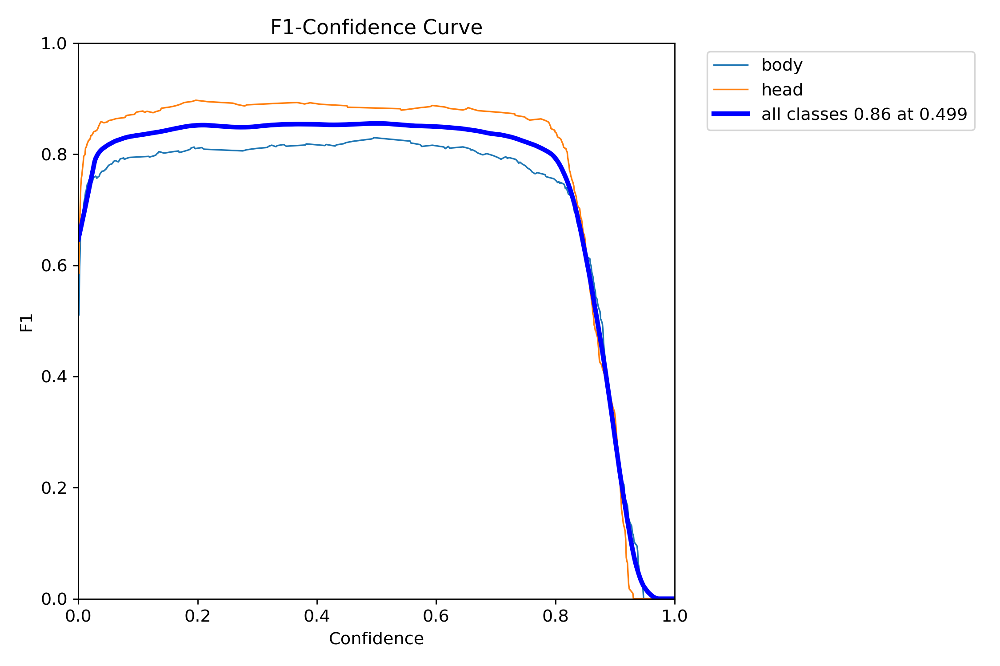

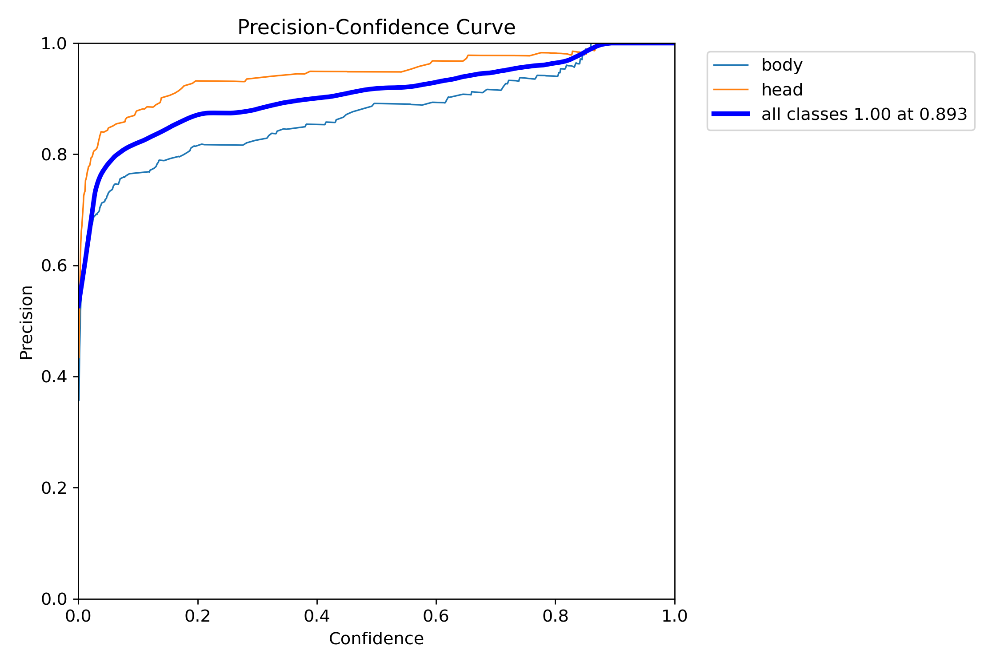

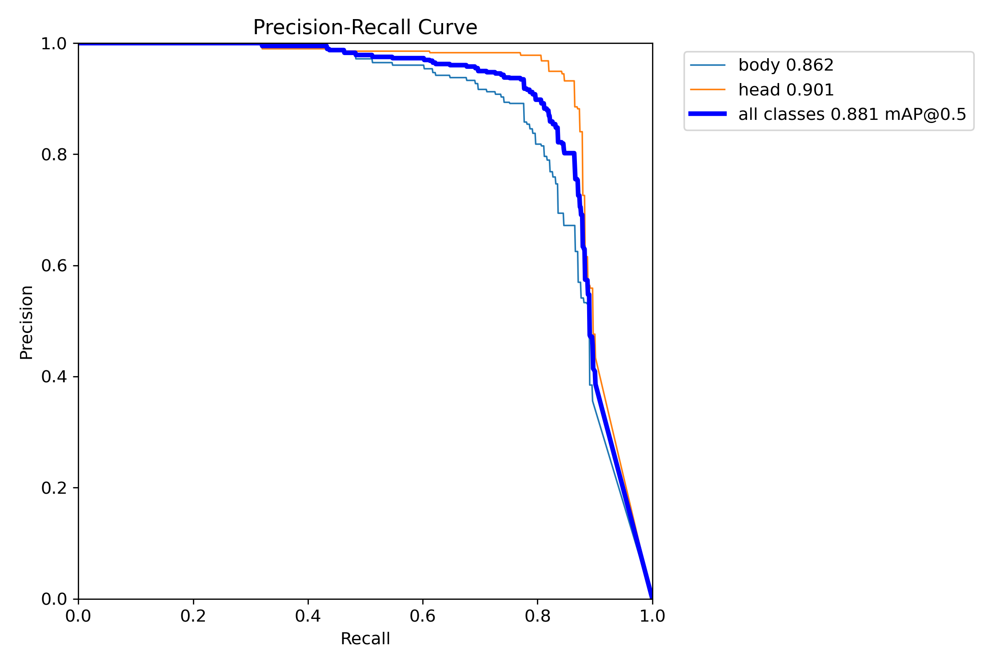

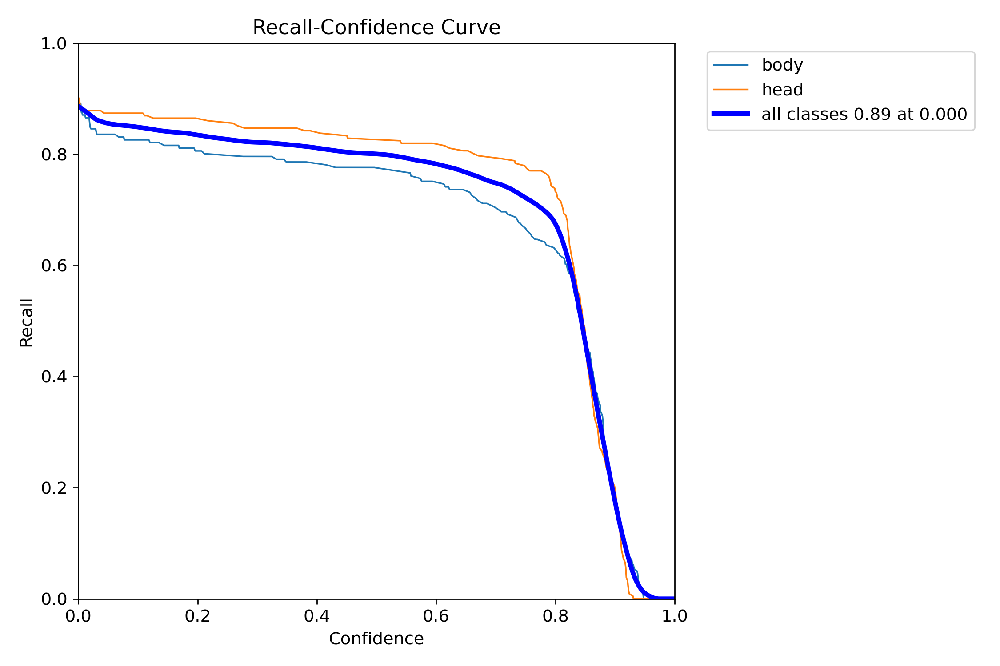

In [ ]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display

x1 = Image(filename='runs/detect/train/F1_curve.png')
x2 = Image(filename='runs/detect/train/P_curve.png')
x3 = Image(filename='runs/detect/train/PR_curve.png')
x4 = Image(filename='runs/detect/train/R_curve.png')

display(x1, x2, x3, x4)

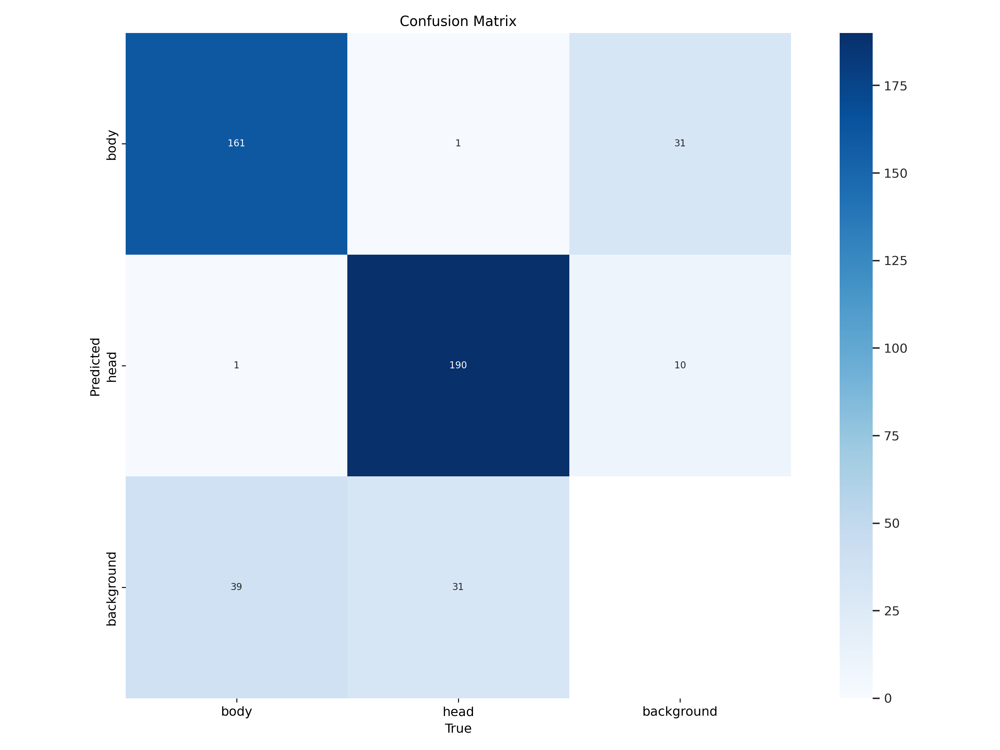

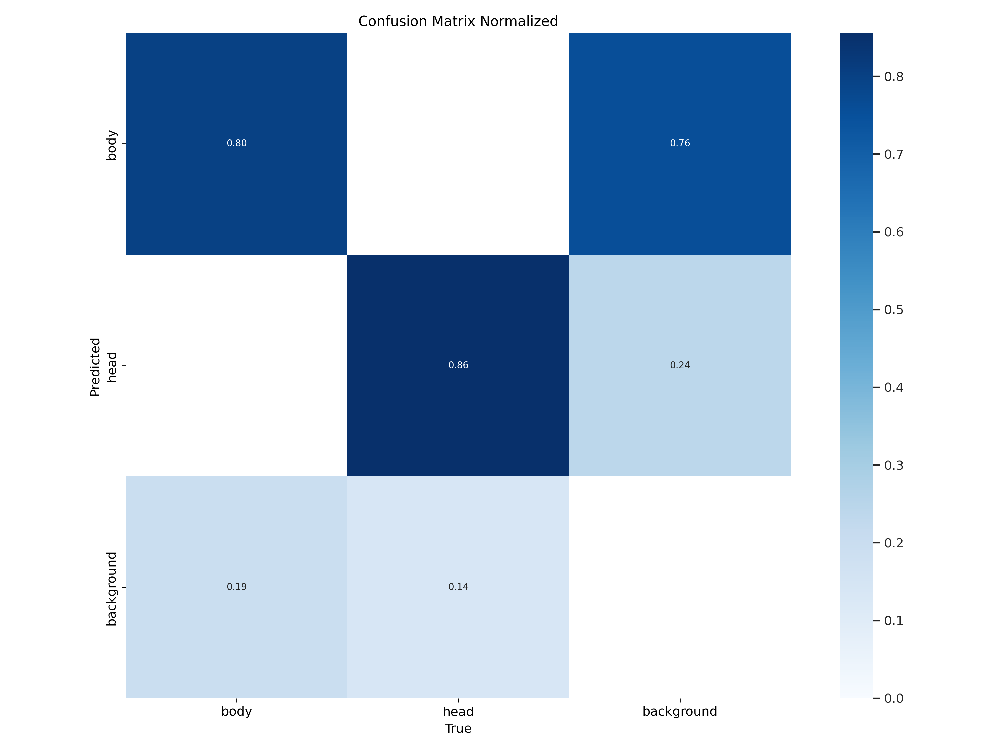

In [ ]:
y1 = Image(filename='runs/detect/train/confusion_matrix.png')
y2 = Image(filename='runs/detect/train/confusion_matrix_normalized.png')
display(y1, y2)

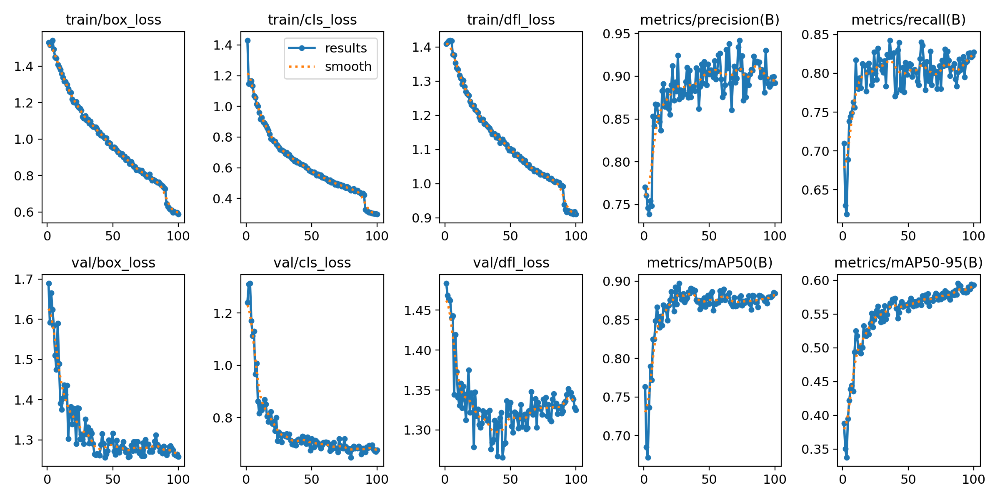

In [ ]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [ ]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [ ]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

video 1/1 (frame 1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 2 bodys, 1 head, 136.9ms
video 1/1 (frame 2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 9.4ms
video 1/1 (frame 3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.7ms
video 1/1 (frame 4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 10.1ms
video 1/1 (frame 8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x

In [ ]:
!ls 'runs/detect/predict'

sit_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  97%|█████████▋| 294/303 [00:01<00:00, 156.36it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

video 1/1 (frame 1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 138.5ms
video 1/1 (frame 2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 8.2ms
video 1/1 (frame 3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 8.5ms
video 1/1 (frame 4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 9.6ms
video 1/1 (frame 6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.5ms
video 1/1 (frame 7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.6ms
video 1/1 (frame 8/308) /content/drive/My Drive/Camera Roll/side_video.mp4

In [ ]:
!ls 'runs/detect/predict2'

side_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict2/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/side-body-final/pretrained-s.pt")

'/content/drive/My Drive/side-body-final/pretrained-s.pt'